In [1]:

import os
import numpy as np
from pathlib import Path
from PIL import Image
import matplotlib
from matplotlib import pyplot as plt
# from nilearn import datasets
# from nilearn import plotting

import torch
import torch.nn as nn
import wandb
import pandas as pd
from tqdm import tqdm
from transformers import BlipProcessor,BlipForConditionalGeneration
import torch.nn.functional as F
from diffusers.models.vae import Decoder
from diffusers.models import AutoencoderKL
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms
from torchvision.io import read_image
from collections import OrderedDict
import torchvision
from torchvision import transforms
from diffusers import StableDiffusionImg2ImgPipeline

c:\Users\SWC\Desktop\Code\Machine-Learning-Final\.venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:

select_ROIs = 2 - 1
random_seed = 1357

In [3]:

def load_image(path):
    fp = open(path, 'rb')
    image = Image.open(fp).convert("RGB")
    image = np.array(image).astype(np.float32) / 255.0   #(425, 425, 3)
    fp.close()
    image = image[None].transpose(0, 3, 1, 2)           # (1, 3, 425, 425)
    image = torch.from_numpy(image)
    return image

def save_image(samples, path):     
    samples = 255 * samples.clamp(0,1)    # (1, 3, 425, 425)
    samples = samples.detach().numpy()
    samples = samples.transpose(0, 2, 3, 1)       #(1, 425, 425, 3)
    image = samples[0]                            #(425, 425, 3)
    image = Image.fromarray(image.astype(np.uint8))
    image.save(path)

def encode_img(input_img, vae):
    # Single image -> single latent in a batch (so size 1, 4, 53, 53)
    if len(input_img.shape)<4:
        input_img = input_img.unsqueeze(0)
    with torch.no_grad():
        latent = vae.encode(input_img*2 - 1) # Note scaling
    return 0.18215 * latent.latent_dist.sample()

def decode_img(latents, vae):
    # bath of latents -> list of images
    latents = (1 / 0.18215) * latents
    with torch.no_grad():
        image = vae.decode(latents).sample
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.detach()
    return image

def transform(image):
    return transforms.Resize([512, 512])(image)

def to_PIL(tensor):
    return torchvision.transforms.ToPILImage()(tensor)

In [4]:

def DoOneRoiMask(data_path, subject_num, data, LR, roi, maskedFmri):

  if roi in ["V1v", "V1d", "V2v", "V2d", "V3v", "V3d", "hV4"]:
      roi_class = 'prf-visualrois'
  elif roi in ["EBA", "FBA-1", "FBA-2", "mTL-bodies"]:
      roi_class = 'floc-bodies'
  elif roi in ["OFA", "FFA-1", "FFA-2", "mTL-faces", "aTL-faces"]:
      roi_class = 'floc-faces'
  elif roi in ["OPA", "PPA", "RSC"]:
      roi_class = 'floc-places'
  elif roi in ["OWFA", "VWFA-1", "VWFA-2", "mfs-words", "mTL-words"]:
      roi_class = 'floc-words'
  elif roi in ["early", "midventral", "midlateral", "midparietal", "ventral", "lateral", "parietal"]:
      roi_class = 'streams'

  # load mask file
  roi_space_dir = os.path.join(data_path, 'subj0{}'.format(subject_num), 'roi_masks',
      LR[0]+'h.'+roi_class+'_space.npy')
  roi_map_dir = os.path.join(data_path, 'subj0{}'.format(subject_num), 'roi_masks',
      'mapping_'+roi_class+'.npy')
  roi_space = np.load(roi_space_dir)
  roi_map = np.load(roi_map_dir, allow_pickle=True).item()

  # Select the vertices corresponding to the ROI of interest
  roi_mapping = list(roi_map.keys())[list(roi_map.values()).index(roi)]

  target_index = np.where(np.isin(roi_space, roi_mapping))[0]

  for i in target_index:
    maskedFmri[:, i] = data[:, i]

  return maskedFmri

In [5]:

def GetRoiMaskedFmri(data_path, subject_num, LR, regions):
  """
    data_path: string -- path to folder for subj0x
    subject_num: int -- subject number for training ex: 1
    LR: string "left" or "right" -- specify the fmri data is left or right hemisphere
    regoins: list of strings of interseted regions, split by bankspace -- ex: ["FFA-1", "OPA"]

    return: masked fmri data -- (n, 19004) or (n, 20054)
  """
  if LR == "left":
    data = np.load(os.path.join(data_path, 'subj0{}'.format(subject_num), 'training_split/training_fmri',
    LR[0]+'h_training_fmri.npy'))
    assert (data.shape[1] == 19004)
  elif LR == "right":
    data = np.load(os.path.join(data_path, 'subj0{}'.format(subject_num), 'training_split/training_fmri',
    LR[0]+'h_training_fmri.npy'))
    assert (data.shape[1] == 20544)

  maskedFmriData = np.zeros_like(data, dtype=float)

  for region in regions:
    DoOneRoiMask(data_path=data_path, subject_num=subject_num, data=data, LR=LR, roi=region, maskedFmri=maskedFmriData)

  return maskedFmriData

In [6]:

# usage

# determine the datapath and training subject
data_path = '/2023-Machine-Learning-Dataset/'
subject_num = 1

# get masked fmri data
ROIs_test1 = ["V1v", "V1d", "V2v", "V2d", "V3v", "V3d", "hV4", "FFA-1", "FFA-2", "PPA"]
ROIs_test2 = ["EBA", "FBA-1", "FBA-2", "mTL-bodies", "OFA", "FFA-1", "FFA-2", "mTL-faces", "aTL-faces", "OPA", "PPA", "RSC"]
ROIs_test3 = ["early", "midventral", "midlateral", "midparietal", "ventral", "lateral", "parietal"]
ROIs_tests = [ROIs_test1, ROIs_test2, ROIs_test3]

lh = GetRoiMaskedFmri(data_path=data_path, subject_num=subject_num, LR="left", regions=ROIs_tests[select_ROIs])
rh = GetRoiMaskedFmri(data_path=data_path, subject_num=subject_num, LR="right", regions=ROIs_tests[select_ROIs])
lrh = np.concatenate((lh, rh), axis=1)

In [8]:

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [9]:

class Voxel2StableDiffusionModel(torch.nn.Module):
    # define the prototype of the module
    def __init__(self, in_dim=39548, h=2048, n_blocks=4):
        super().__init__()

        self.lin0 = nn.Sequential(
            nn.Linear(in_dim, h, bias=False),
            nn.LayerNorm(h),
            nn.SiLU(inplace=True),
            nn.Dropout(0.5),
        )

        self.mlp = nn.ModuleList([
            nn.Sequential(
                nn.Linear(h, h, bias=False),
                nn.LayerNorm(h),
                nn.SiLU(inplace=True),
                nn.Dropout(0.3),
            ) for _ in range(n_blocks)
        ])

        self.lin1 = nn.Linear(h, 16384, bias=False)
        self.norm = nn.GroupNorm(1, 64)

        def init_weights(m):
            if isinstance(m, nn.Linear):
                torch.nn.init.xavier_uniform_(m.weight)

        init_weights(self.lin0)
        self.mlp.apply(init_weights)
        init_weights(self.lin1)

        self.upsampler = Decoder(
            in_channels=64,
            out_channels=4,
            up_block_types=["UpDecoderBlock2D","UpDecoderBlock2D","UpDecoderBlock2D"],
            block_out_channels=[64, 128, 256],
            layers_per_block=1,
        )
        for parm in self.upsampler.parameters():
            parm.require_grad = False
        self.upsampler.eval()

    # define how it forward, using the module defined above
    def forward(self, x):
        x = self.lin0(x)
        residual = x
        for res_block in self.mlp:
            x = res_block(x)
            x = x + residual
            residual = x
        x = x.reshape(len(x), -1)
        x = self.lin1(x)
        x = self.norm(x.reshape(x.shape[0], -1, 16, 16).contiguous())
        return self.upsampler(x)

In [10]:

voxel2sd = Voxel2StableDiffusionModel().to(device)

In [11]:

# from torchsummary import summary
# summary(voxel2sd, (39548,))

In [12]:

# some hyperparameters
batch_size = 32
num_epochs = 200
num_train = 5000
lr_scheduler = 'cycle'
initial_lr = 1e-4
max_lr = 5e-4
# random_seed = 9213
train_size = 0.7
valid_size = 1 - train_size
num_workers = torch.cuda.device_count()

In [13]:

# some path information
dataset_path = '/2023-Machine-Learning-Dataset/'
training_path = dataset_path + 'subj0{}/training_split/'
training_fmri_path = training_path + 'training_fmri/'
training_images_path = training_path + 'training_images/'
training_encoded_image_path = training_path + 'encoded_images/output.npy'
testing_path = dataset_path + 'subj0{}/test_split/test_fmri/'

In [14]:
processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-large")
vae = AutoencoderKL.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="vae").to(device)
modelGeneration = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-large", torch_dtype=torch.float16).to(device)
sdPipe = StableDiffusionImg2ImgPipeline.from_pretrained("runwayml/stable-diffusion-v1-5",torch_dtype=torch.float16).to(device)

Loading pipeline components...:  29%|██▊       | 2/7 [00:00<00:00, 11.70it/s]`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.
Loading pipeline components...: 100%|██████████| 7/7 [00:01<00:00,  4.03it/s]


In [15]:
class MyDataset(Dataset):
  def __init__(self, fmri_data, encoded_images_path, transform=None):
    self.fmri_data = fmri_data
    self.transform = transform
    with open(encoded_images_path, 'rb') as f:
      self.image_latents = np.load(f)
    self.image_latents = list(map(torch.from_numpy, self.image_latents))

  def __len__(self):
    return len(self.fmri_data)

  def __getitem__(self, idx):
    fmri = self.fmri_data[idx]
    image_latent = self.image_latents[idx]

    return fmri, image_latent

In [16]:

transform = transforms.Resize([512, 512])
my_dataset = MyDataset(lrh, training_encoded_image_path.format(1), transform=transform)

In [17]:

# train-val split
generator = torch.Generator().manual_seed(random_seed)
trainset, validset = random_split(my_dataset, [train_size, valid_size], generator=generator)

In [18]:

# build dataloader
train_dataloader = DataLoader(trainset, batch_size=batch_size, shuffle=False, num_workers=0)
val_dataloader = DataLoader(validset, batch_size=batch_size, shuffle=False, num_workers=0)

In [19]:

no_decay = ['bias', 'LayerNorm.bias', 'LayerNorm.weight']
opt_grouped_parameters = [
    {'params': [p for n, p in voxel2sd.named_parameters() if not any(nd in n for nd in no_decay)], 'weight_decay': 1e-2},
    {'params': [p for n, p in voxel2sd.named_parameters() if any(nd in n for nd in no_decay)], 'weight_decay': 0.0}
]

In [20]:

optimizer = torch.optim.AdamW(opt_grouped_parameters, lr=initial_lr)
lr_scheduler = torch.optim.lr_scheduler.OneCycleLR(optimizer, max_lr=max_lr,
                                            total_steps=num_epochs*((num_train//batch_size)//num_workers),
                                            final_div_factor=1000,
                                            last_epoch=-1, pct_start=2/num_epochs)
# lr_scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer,
#                                                    milestones=[50*i for i in range(num_epochs*((num_train//batch_size)//num_workers//50))],
#                                                    gamma=0.1)

In [22]:

epoch = 0
progress_bar = tqdm(range(epoch, num_epochs), ncols=150)
losses = []
val_losses = []
lrs = []

  0%|                                                                                                                         | 0/200 [00:00<?, ?it/s]

In [23]:
checkpoint = torch.load('./199') # [TODO] 修改 Model 編號
voxel2sd.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch'] + 1
loss = checkpoint['loss']


  0%|                                                                                                                         | 0/200 [00:00<?, ?it/s]


In [36]:
loss = 0

voxel2sd.eval()
model.eval()
for val_i, data in enumerate(val_dataloader):
    voxels, image_latents = data
    voxels = voxels.to(device).float()
    image_latents = image_latents.to(device).float()
    # run image encoder
    encoded_latents = torch.cat([x for x in image_latents])
    # MLP forward
    encoded_predict = voxel2sd(voxels)


there is a plane flying through the clouds in the sky


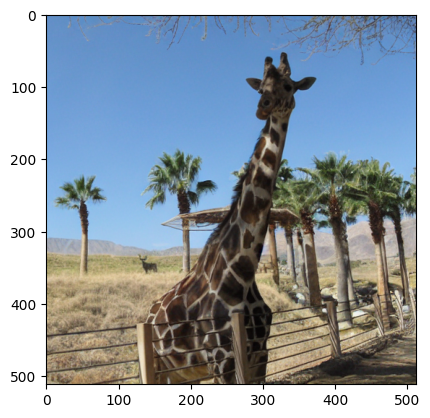

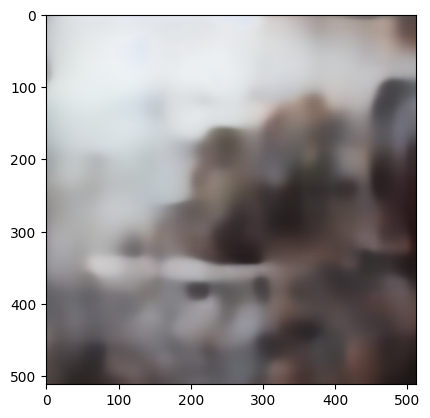

100%|██████████| 37/37 [00:05<00:00,  6.80it/s]


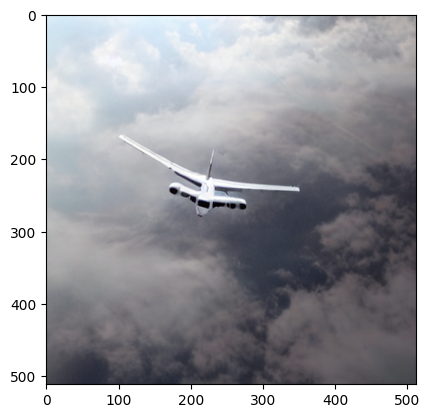

blurred image of a deer in the woods with a background


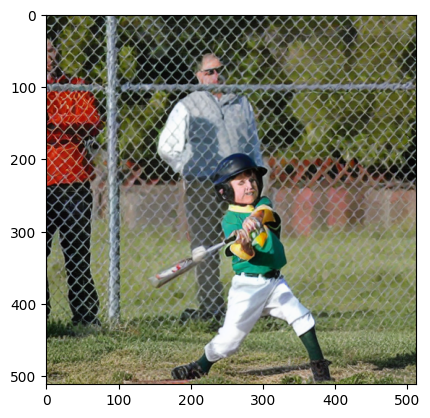

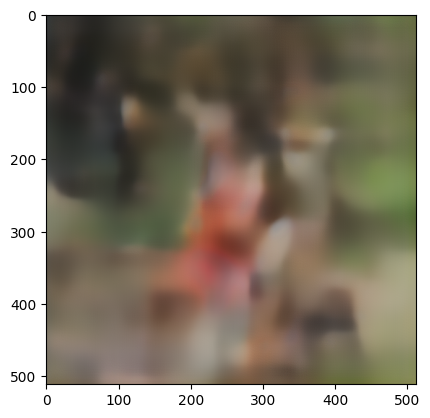

100%|██████████| 37/37 [00:05<00:00,  6.82it/s]


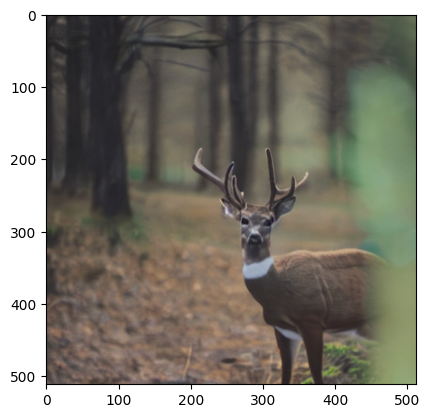

there is a image of a group of people in a field


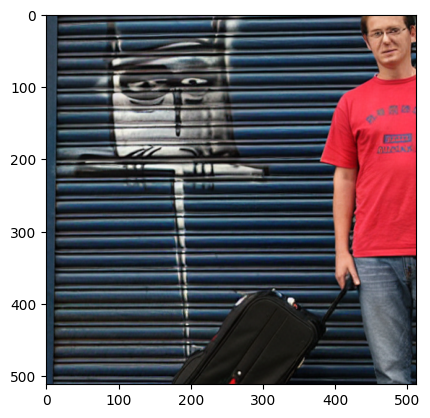

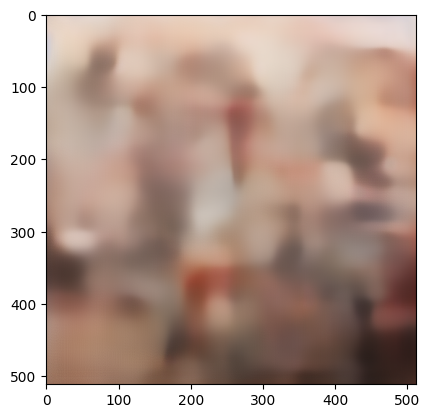

100%|██████████| 37/37 [00:05<00:00,  6.79it/s]


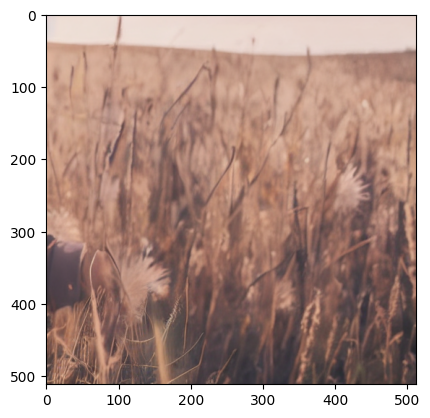

there is a photo of a bird flying in the sky


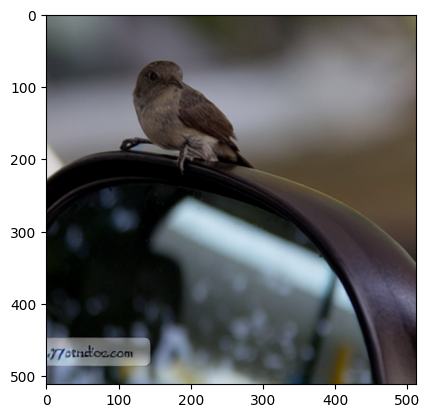

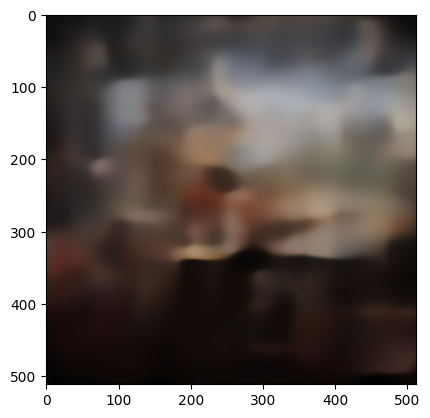

100%|██████████| 37/37 [00:05<00:00,  6.85it/s]


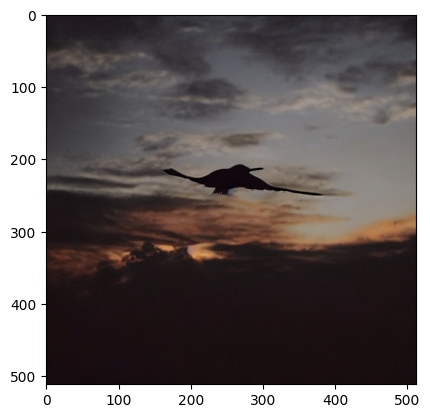

there is a photo of a plane flying in the sky


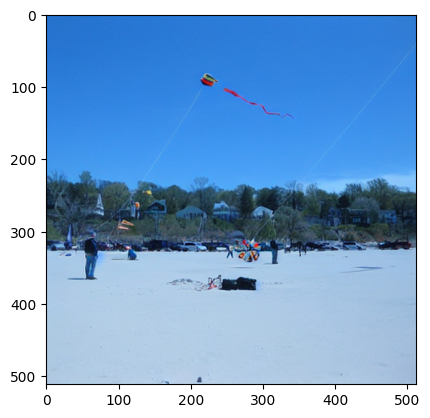

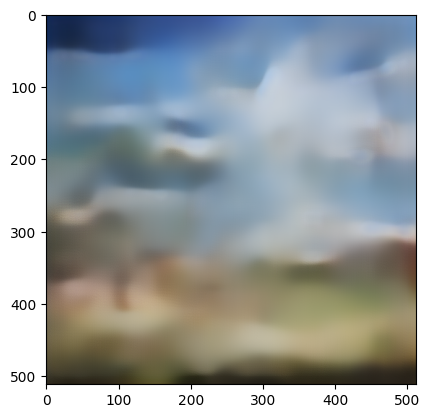

100%|██████████| 37/37 [00:05<00:00,  6.91it/s]


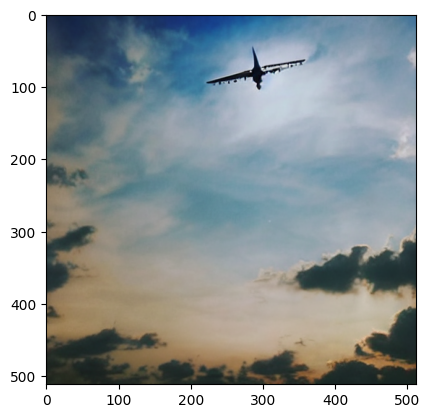

there is a photo of a man riding a motorcycle


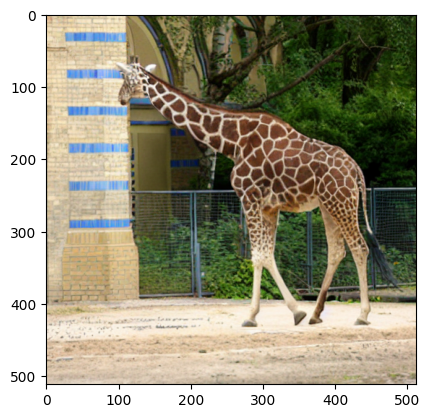

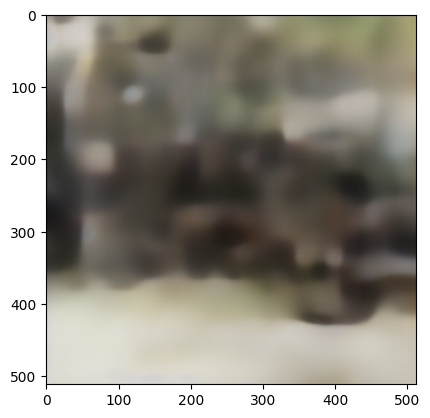

100%|██████████| 37/37 [00:05<00:00,  6.83it/s]


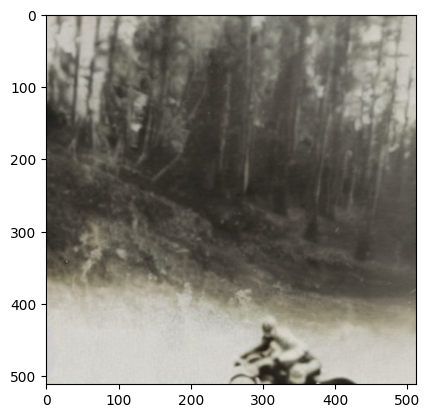

there are two birds that are standing in the grass


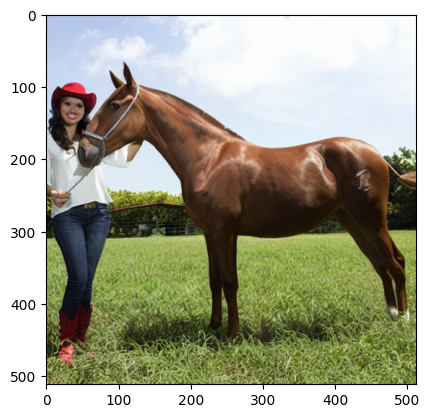

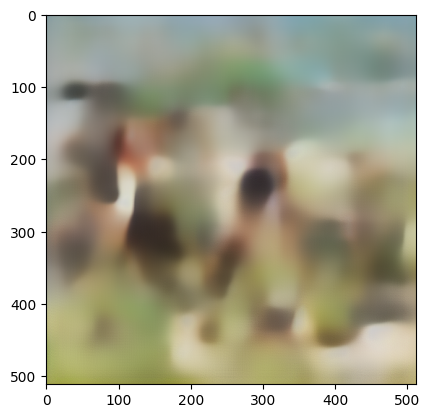

100%|██████████| 37/37 [00:05<00:00,  6.62it/s]


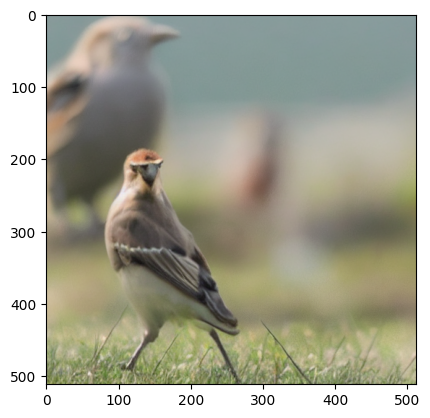

there is a bird that is standing on a rock in the grass


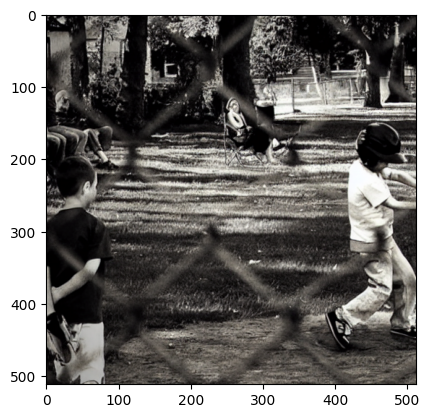

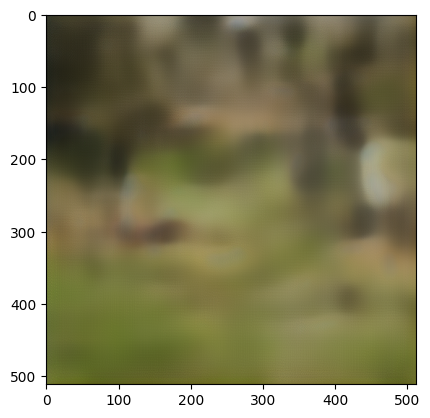

100%|██████████| 37/37 [00:05<00:00,  6.75it/s]


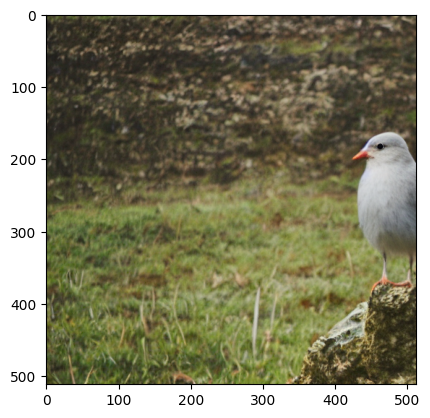

there is a photo of a pile of food on a plate


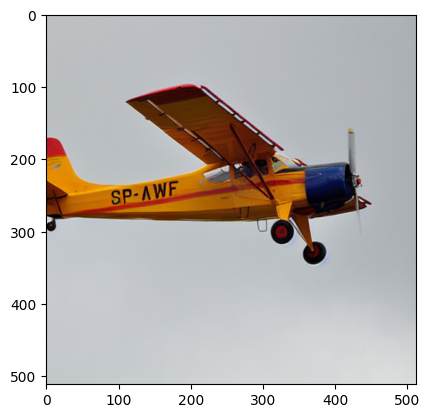

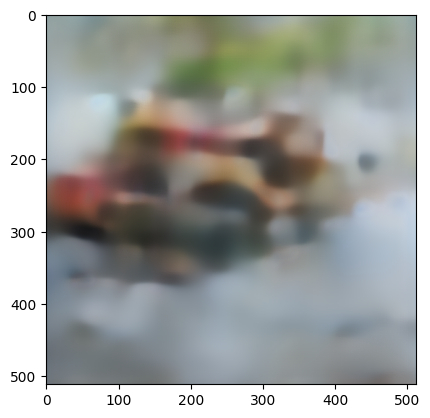

100%|██████████| 37/37 [00:05<00:00,  6.78it/s]


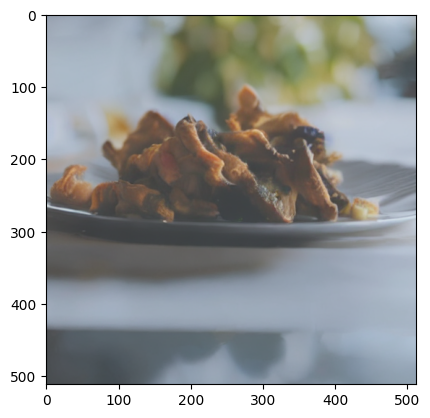

there is a image of a bird sitting on a branch


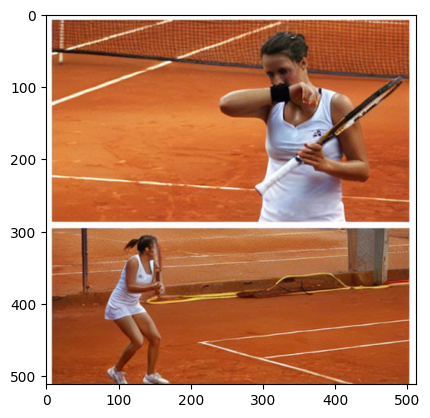

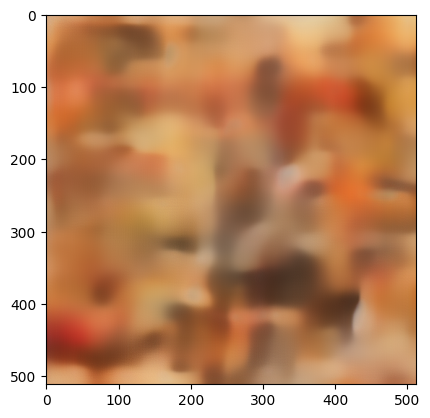

100%|██████████| 37/37 [00:05<00:00,  6.76it/s]


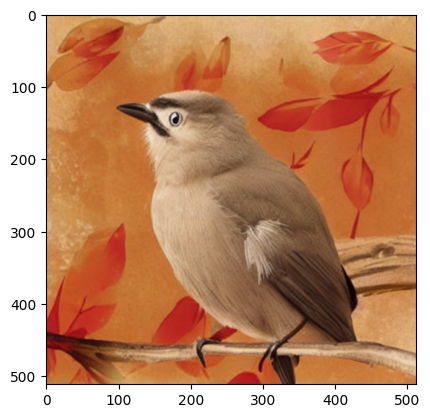

there is a image of a bunch of bananas on a plate


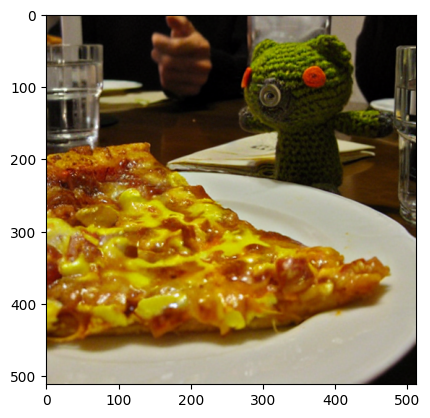

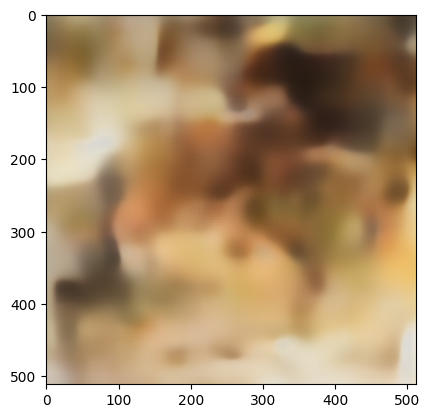

100%|██████████| 37/37 [00:05<00:00,  6.85it/s]


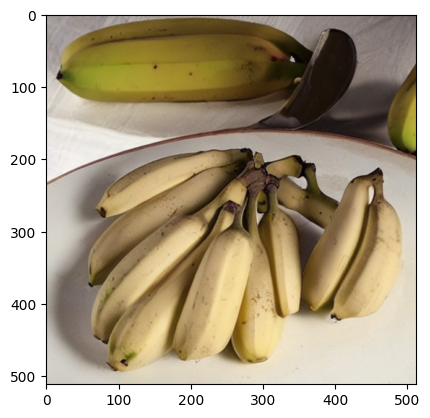

there is a bird that is flying in the sky with a background


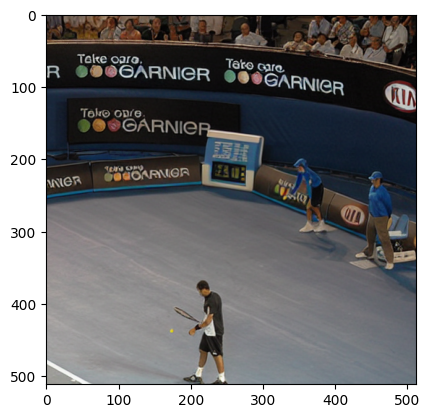

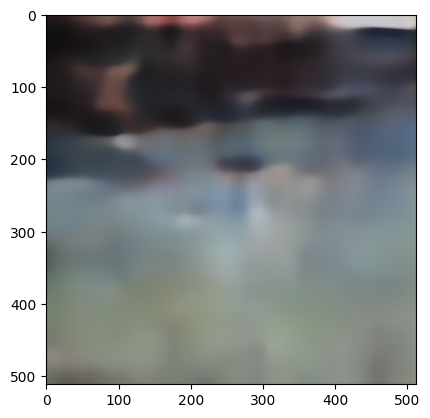

100%|██████████| 37/37 [00:05<00:00,  6.78it/s]


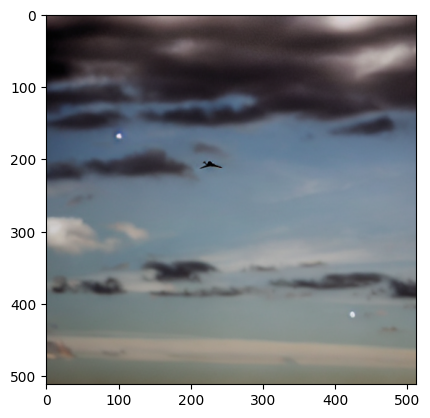

image of a man's face with a background


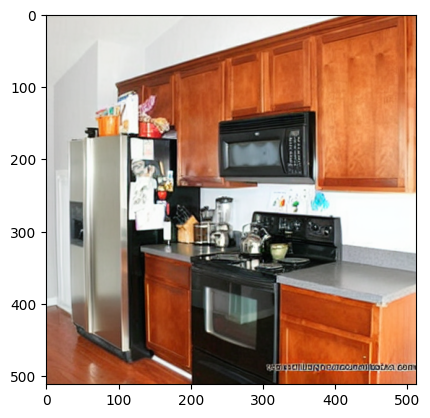

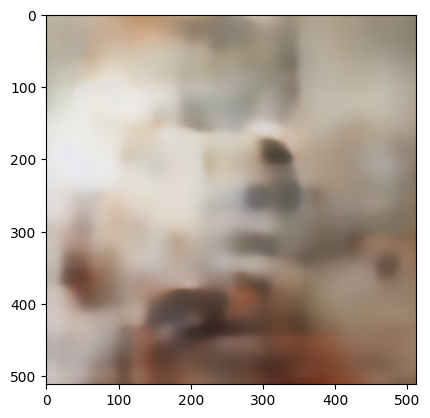

100%|██████████| 37/37 [00:05<00:00,  6.79it/s]


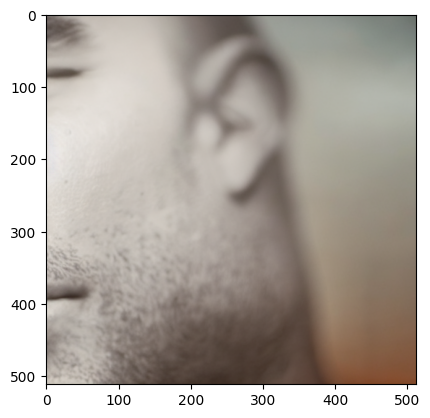

image of a person with an umbrella in the fog


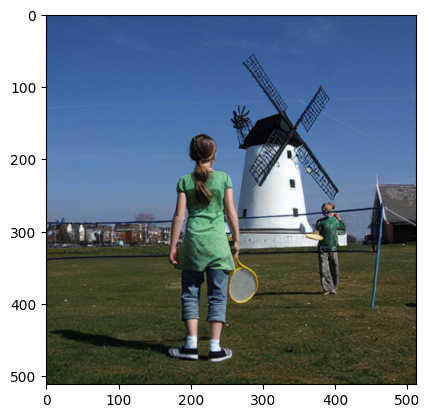

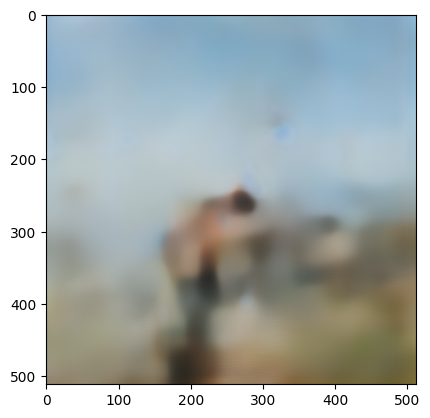

100%|██████████| 37/37 [00:05<00:00,  6.80it/s]


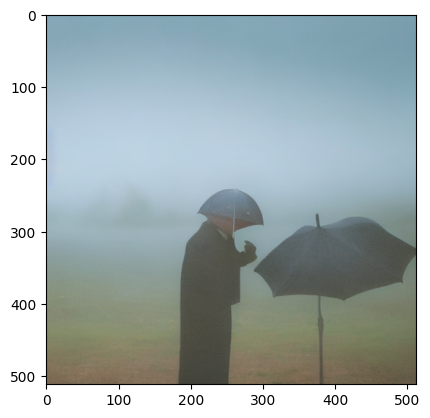

there is a photo of a cat with a red nose


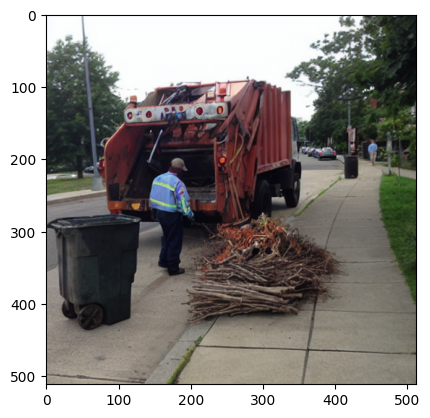

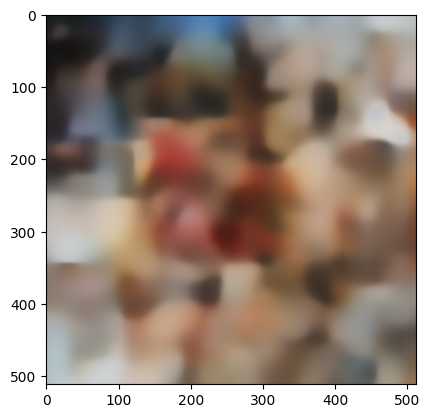

100%|██████████| 37/37 [00:05<00:00,  6.83it/s]


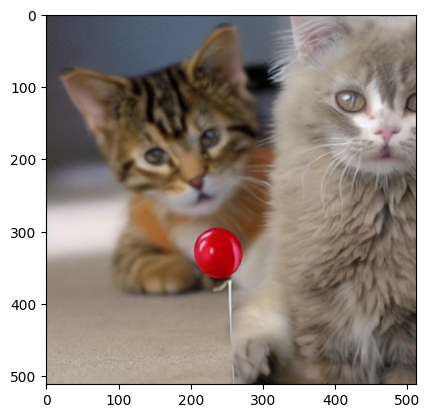

blurred image of a deer in the wild with people in the background


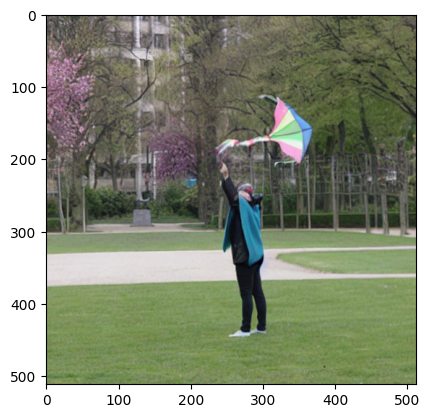

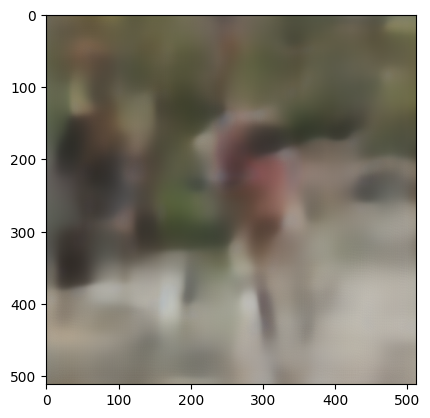

100%|██████████| 37/37 [00:05<00:00,  6.73it/s]


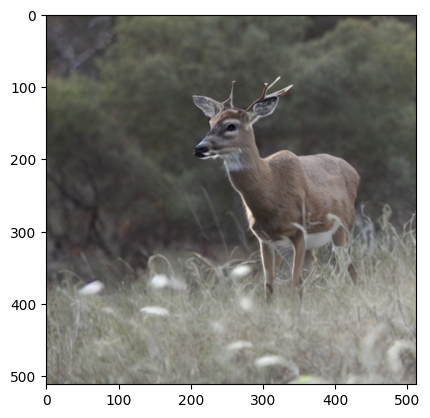

there is a bird that is sitting on a branch of a tree


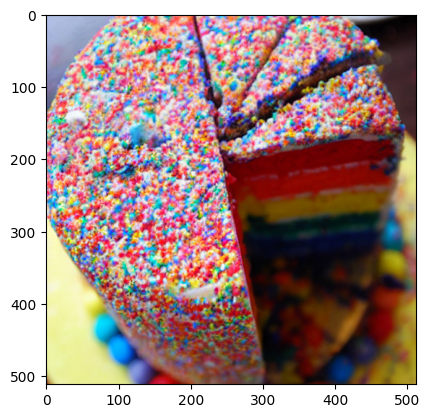

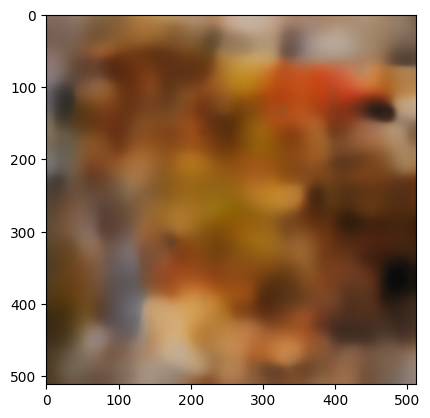

100%|██████████| 37/37 [00:05<00:00,  6.65it/s]


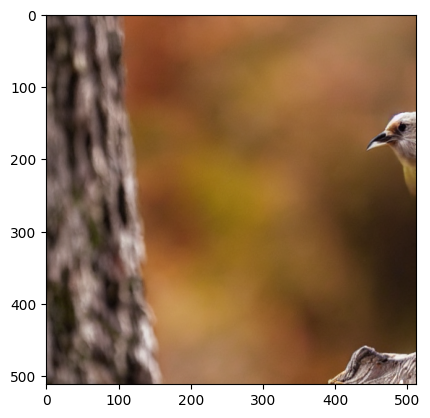

there is a bird that is sitting on a branch in the air


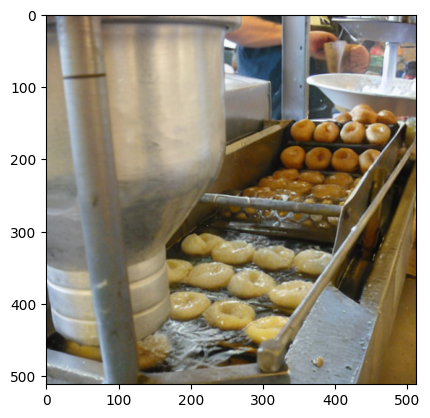

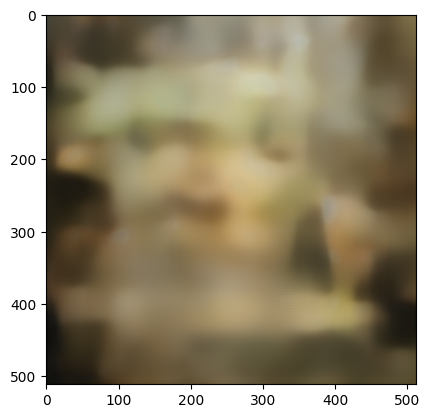

100%|██████████| 37/37 [00:05<00:00,  6.87it/s]


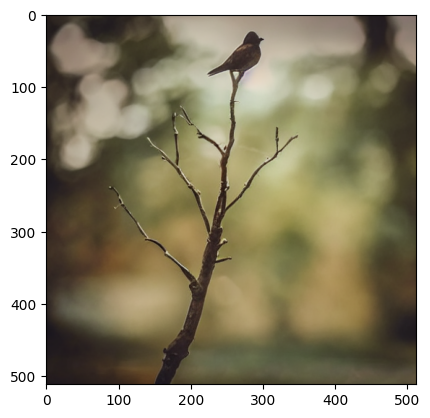

there is a bird that is sitting on a tree branch


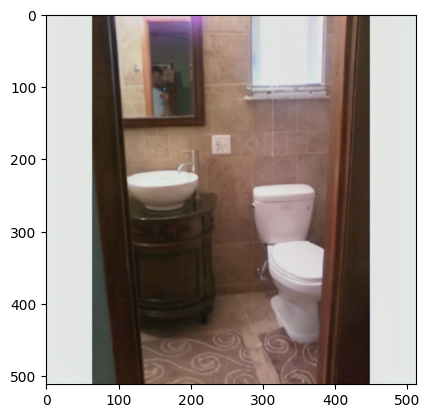

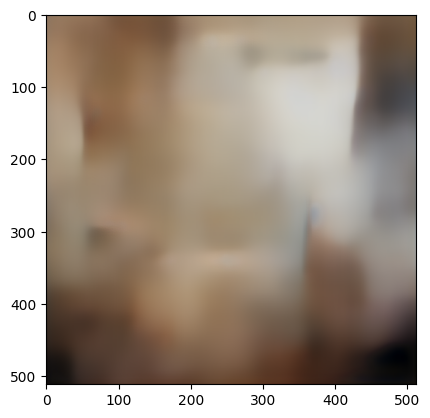

100%|██████████| 37/37 [00:05<00:00,  6.88it/s]


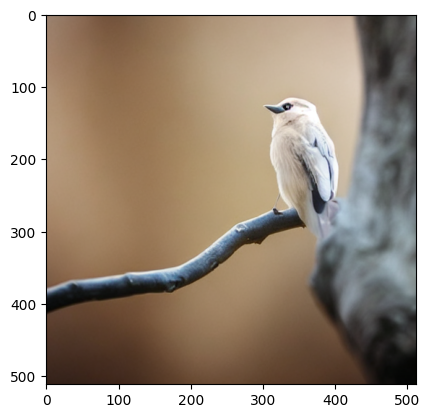

there is a bird that is sitting on a branch in the grass


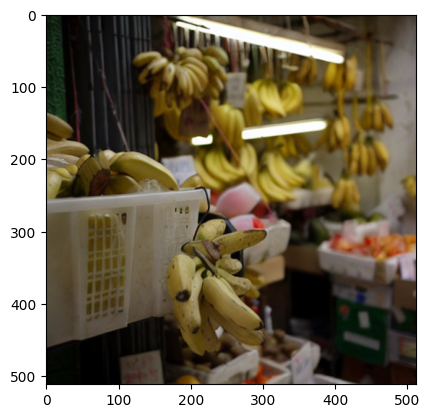

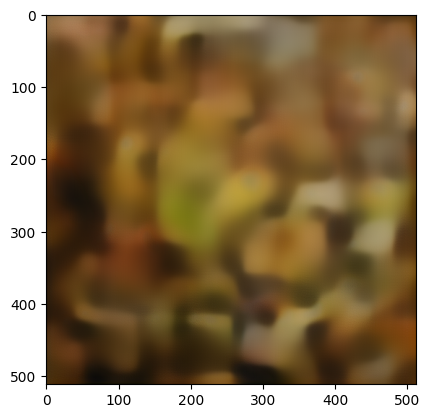

100%|██████████| 37/37 [00:05<00:00,  6.80it/s]


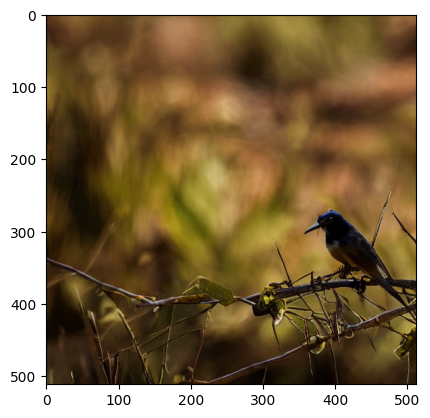

image of a man sitting on a couch with a remote control


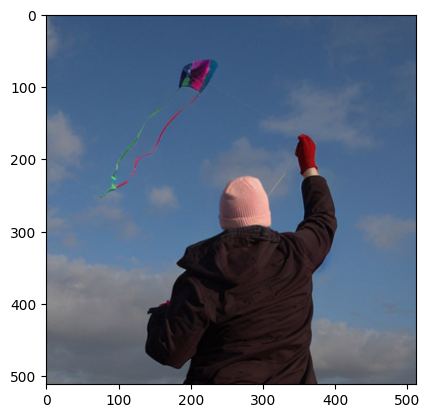

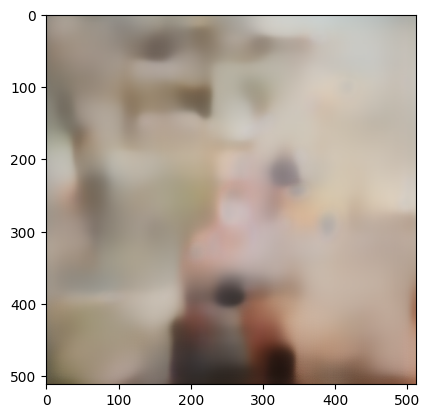

100%|██████████| 37/37 [00:05<00:00,  6.63it/s]


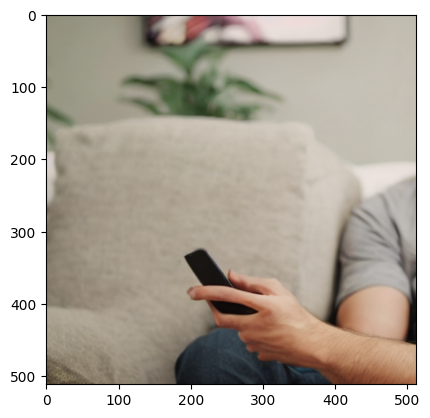

there is a bird that is sitting on a tree branch


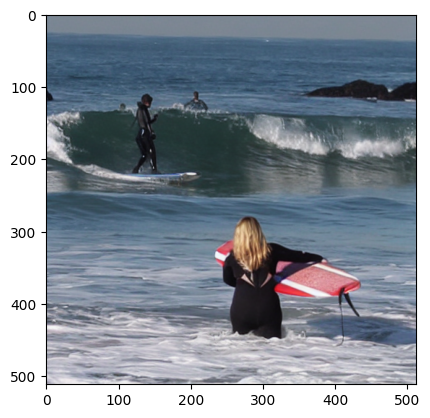

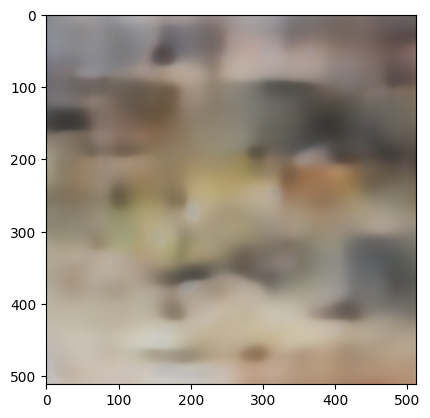

100%|██████████| 37/37 [00:05<00:00,  6.50it/s]


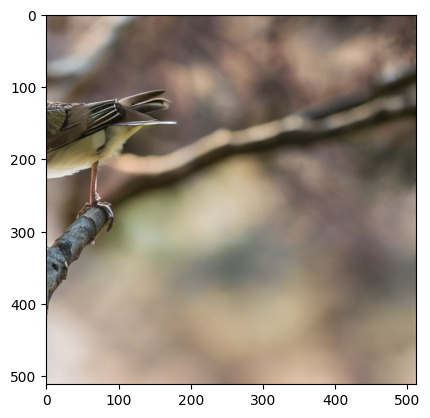

there is a image of a person walking in the rain


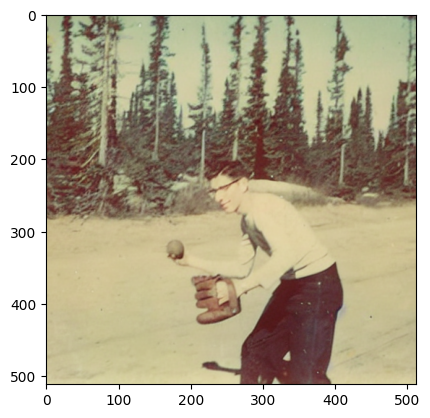

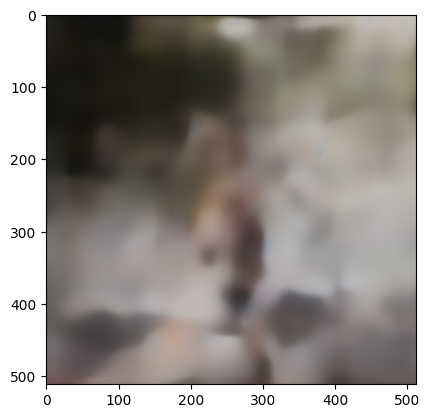

100%|██████████| 37/37 [00:05<00:00,  6.75it/s]


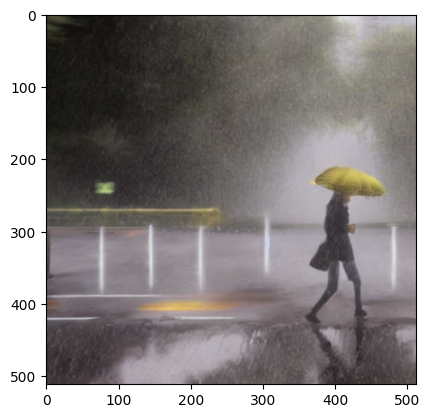

there are many birds flying in the sky above a building


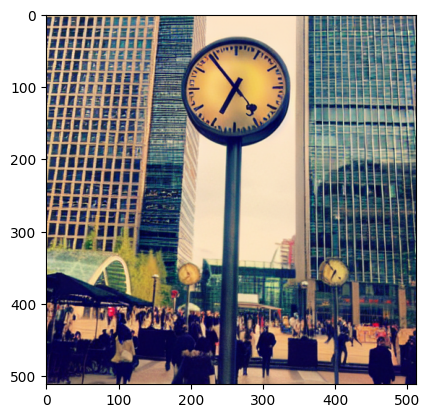

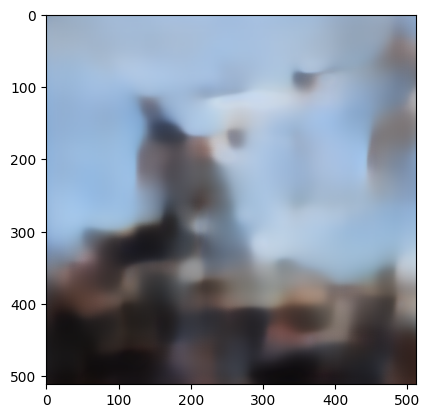

100%|██████████| 37/37 [00:05<00:00,  6.70it/s]


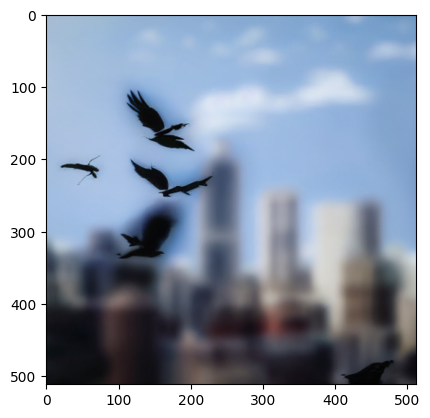

there is a image of a person holding a cell phone


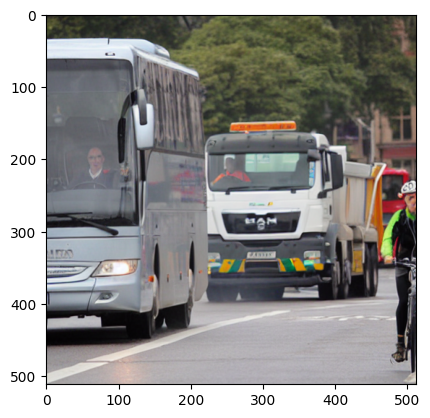

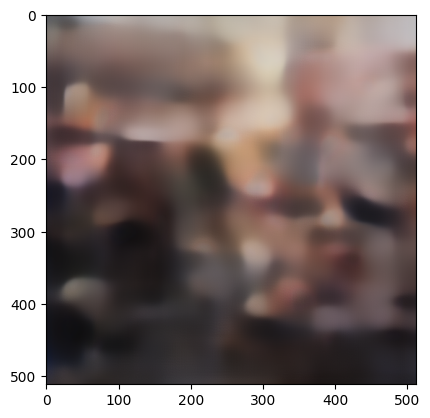

100%|██████████| 37/37 [00:05<00:00,  7.04it/s]


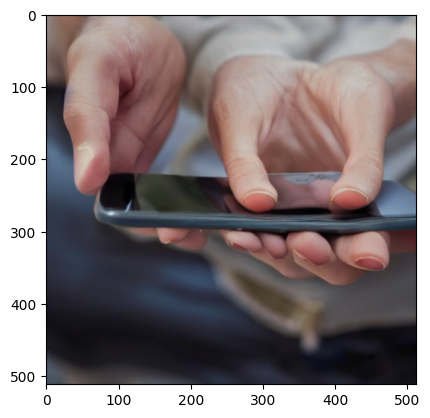

there is a image of a woman in a white dress


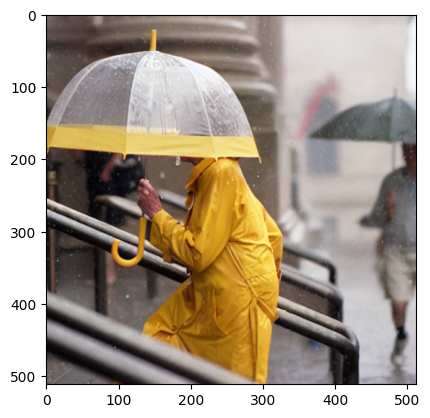

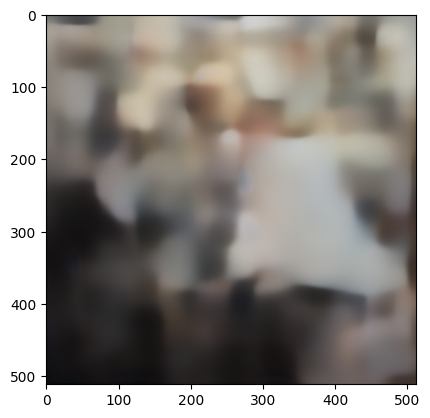

100%|██████████| 37/37 [00:05<00:00,  6.78it/s]


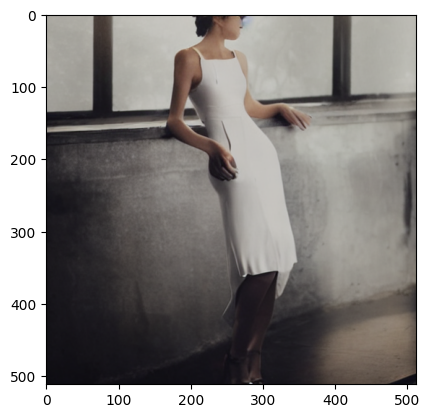

image of a person walking in the fog with a dog


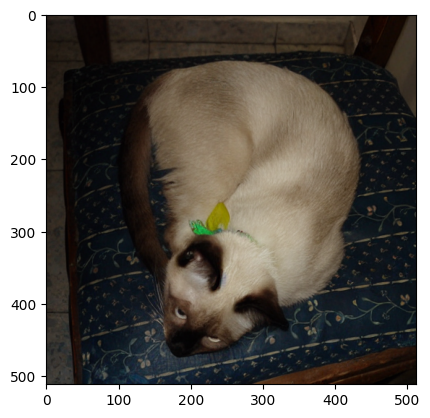

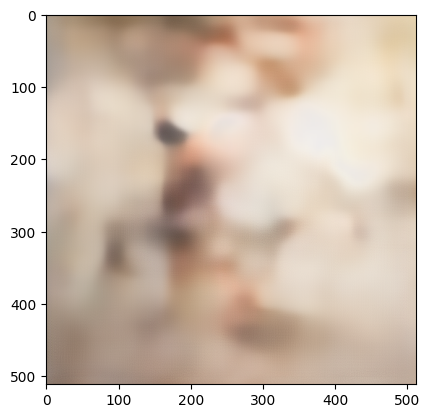

100%|██████████| 37/37 [00:05<00:00,  6.70it/s]


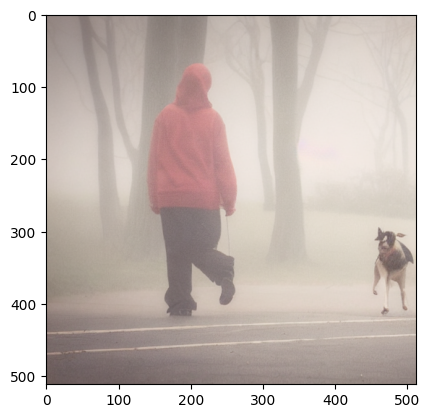

there is a photo of a person holding a cell phone


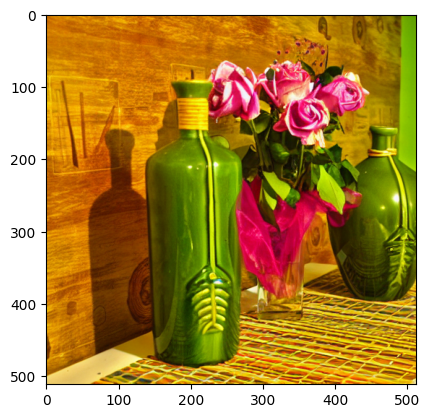

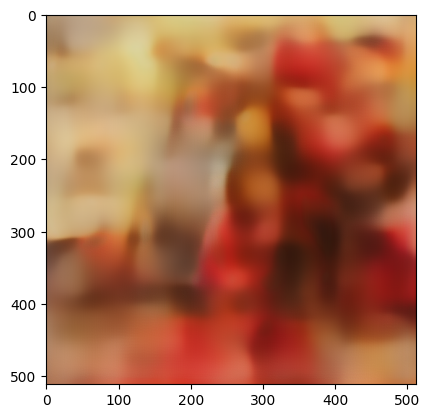

100%|██████████| 37/37 [00:05<00:00,  6.81it/s]


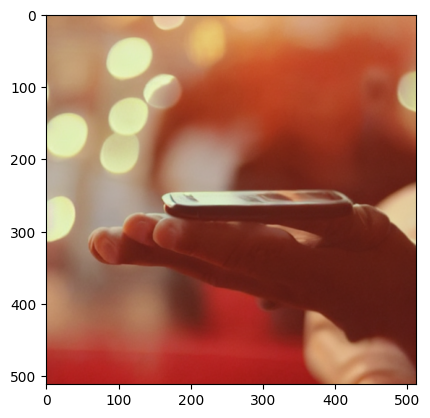

In [37]:
count = 0
for image, latent in zip(encoded_latents,encoded_predict):
   # print(image.shape)
   originImg = to_PIL(decode_img(image.unsqueeze(0),vae)[0])
   latentImg = to_PIL(decode_img(latent.unsqueeze(0),vae)[0])
   out = transforms.Resize((384,384))(decode_img(latent.unsqueeze(0),vae)[0])
   out = modelGeneration.generate(out.unsqueeze(0)).to(device)
   prompt = processor.decode(out[0], skip_special_tokens=True).replace('blurry ', '')
   print(prompt)
   plt.imshow(originImg)
   # originImg.save(f"./outputImg/origin_{count}.png")
   plt.show()
   plt.imshow(latentImg)
   # latentImg.save(f"./outputImg/low_{count}.png")
   plt.show()
   retrieveImg = sdPipe(prompt=prompt, image=latentImg,strength=0.75, guidance_scale=6).images[0]
   plt.imshow(retrieveImg)
   # retrieveImg.save(f"./outputImg/sd_{count}.png")
   plt.show()
   count += 1